# Import libraries

In [ ]:
import argparse
import cv2
import numpy as np
import os
import pandas as pd
import tensorflow as tf
import random
import sys
import matplotlib.pyplot as plt

from typing import List, Tuple
from tqdm import tqdm

import warnings
warnings.filterwarnings("ignore")

from src.models.resnet import ResNet18

# Functions to preprocess the test set

In [6]:
def generateRandomMask(
        mask_size: Tuple[int, int],
        img_size: Tuple[int, int],
        n_masks: int
        ):

    mask = np.full((img_size[0], img_size[1]), 255)

    for _ in range(n_masks):
        x = random.randint(0, img_size[0]- mask_size[0])
        y = random.randint(0, img_size[1]- mask_size[1])
        mask[x:x+mask_size[0], y:y+mask_size[1]] = 0

    return mask

In [ ]:
def get_dataset(
        dataset_path: str,
        ) -> Tuple[List[tf.Tensor], List[tf.Tensor]]:

    x_test, y_true = [], []
    for img in os.listdir(dataset_path):
        # Read images
        img_path = os.path.join(dataset_path, img)
        gt_image = cv2.imread(img_path)
        gt_image = cv2.cvtColor(gt_image, cv2.COLOR_BGR2RGB)
        # Resize and generate input image
        gt_image = cv2.resize(gt_image, (224, 224))
        # Generate masked image
        mask = generateRandomMask((32, 32), (224, 224), 5)
        mask = np.repeat(mask[:, :, np.newaxis], 3, axis=-1)
        input_image = (gt_image * (mask / 255))
        # Insert batch axis
        input_image = tf.expand_dims(tf.cast(input_image, tf.float32) / 255., axis=0)
        gt_image = tf.expand_dims(tf.cast(gt_image, tf.float32) / 255., axis=-1)

        x_test.append(input_image)
        y_true.append(gt_image)
    
    return x_test, y_true

# Inference

Download the inpainting model weights here: https://drive.google.com/file/d/1giLKaR6FnhZXNZFcp9OgfNjY2XCwrtOH/view?usp=sharing 

  0%|          | 0/29 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


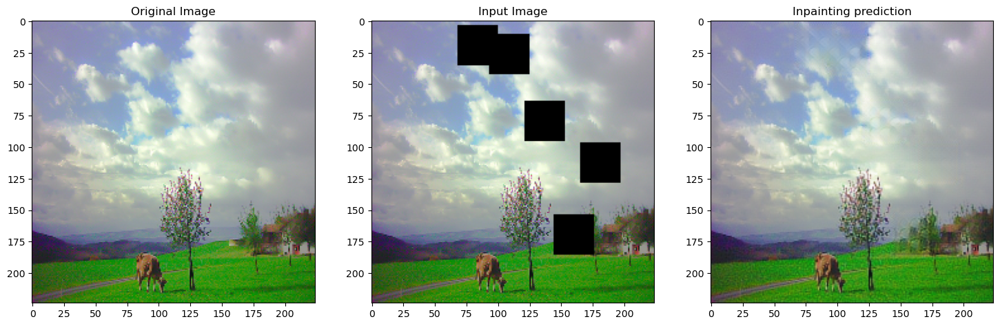

  3%|▎         | 1/29 [00:03<01:24,  3.01s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


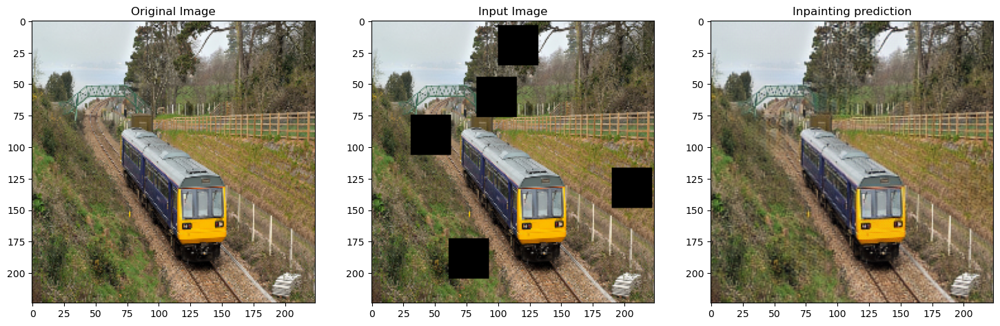

  7%|▋         | 2/29 [00:03<00:45,  1.69s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


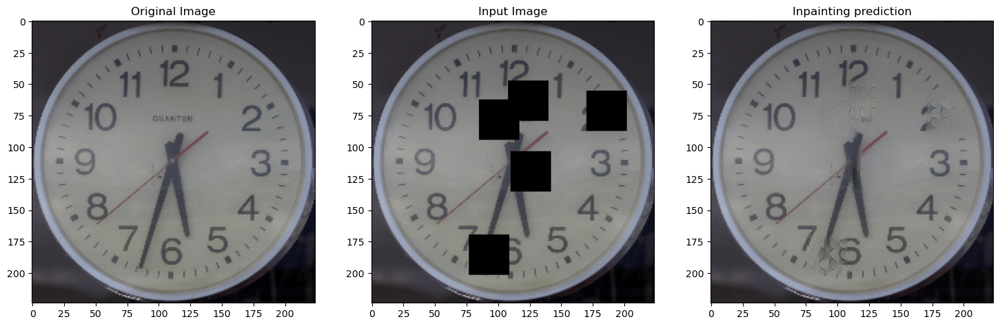

 10%|█         | 3/29 [00:04<00:33,  1.27s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


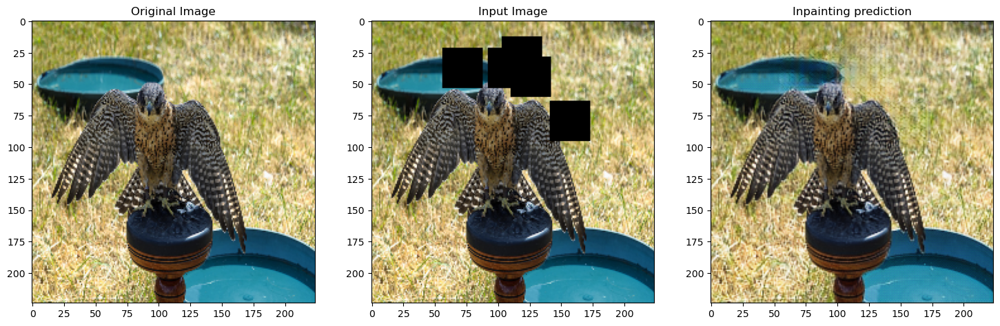

 14%|█▍        | 4/29 [00:05<00:26,  1.08s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


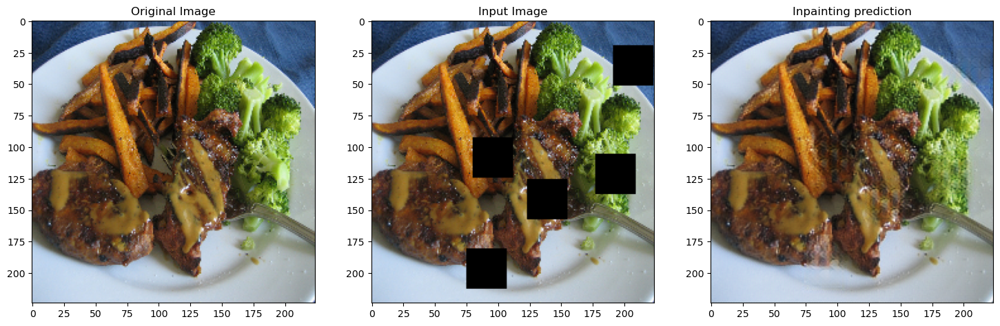

 17%|█▋        | 5/29 [00:06<00:23,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


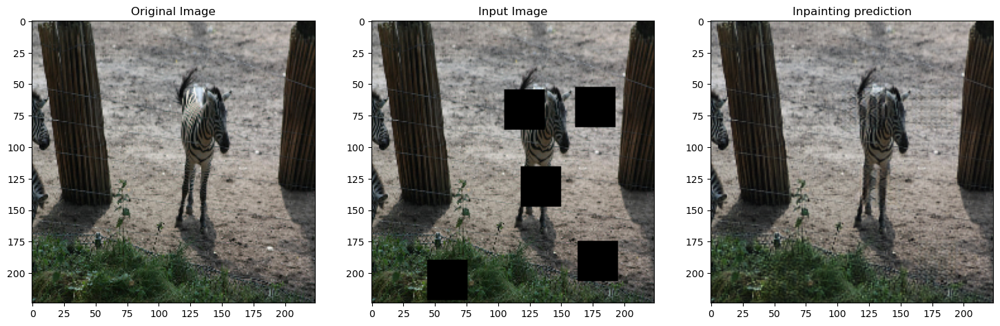

 21%|██        | 6/29 [00:06<00:20,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


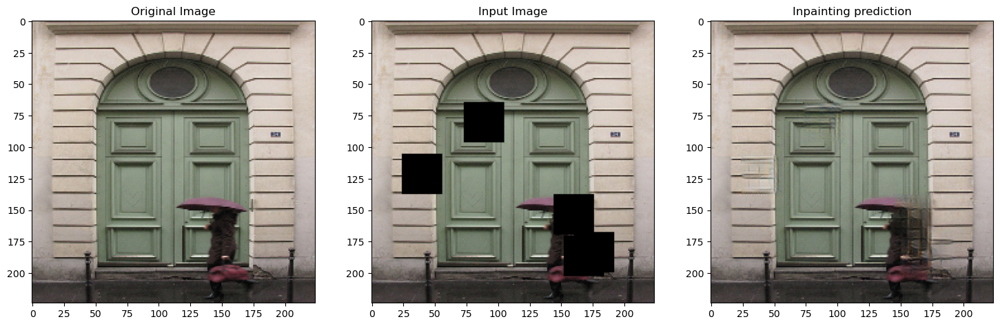

 24%|██▍       | 7/29 [00:07<00:19,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


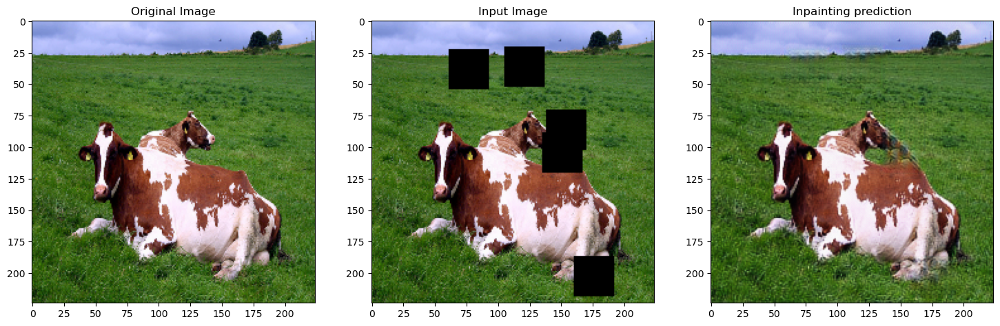

 28%|██▊       | 8/29 [00:08<00:17,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


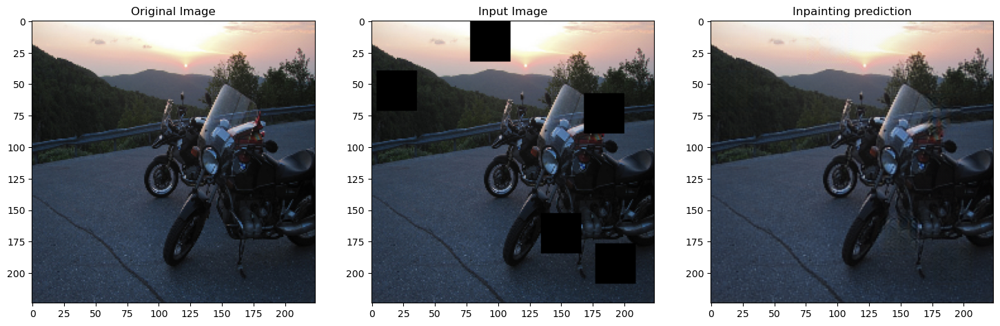

 31%|███       | 9/29 [00:09<00:16,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


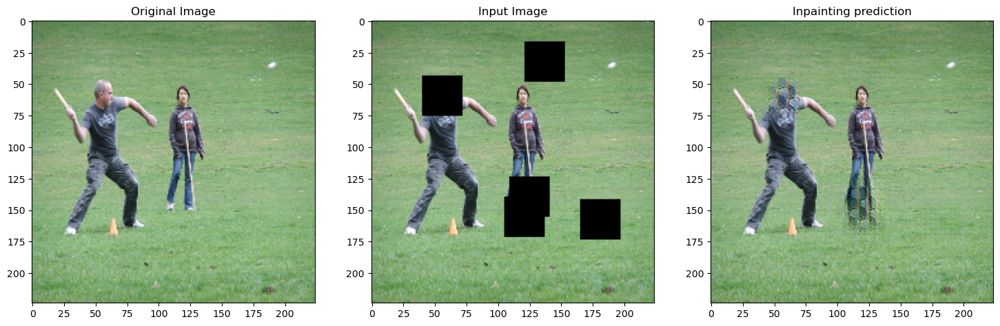

 34%|███▍      | 10/29 [00:10<00:15,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


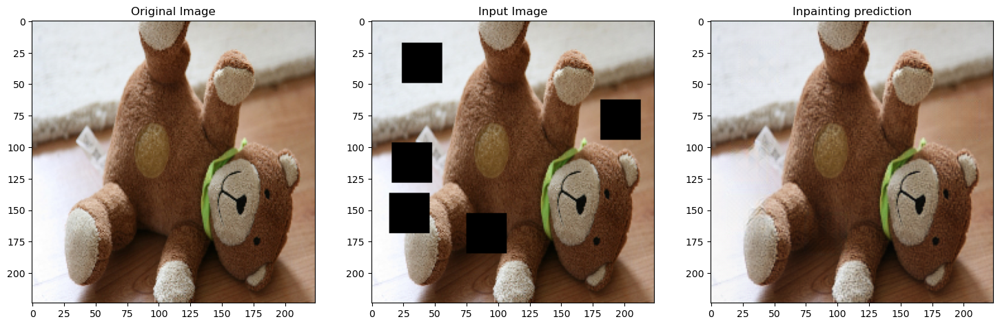

 38%|███▊      | 11/29 [00:10<00:14,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


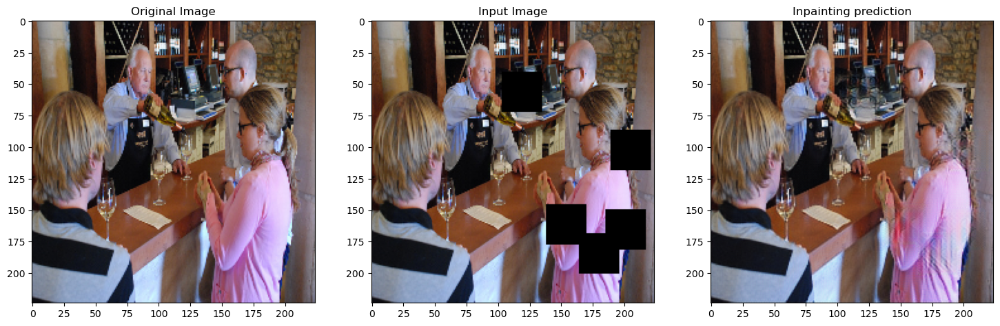

 41%|████▏     | 12/29 [00:11<00:13,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


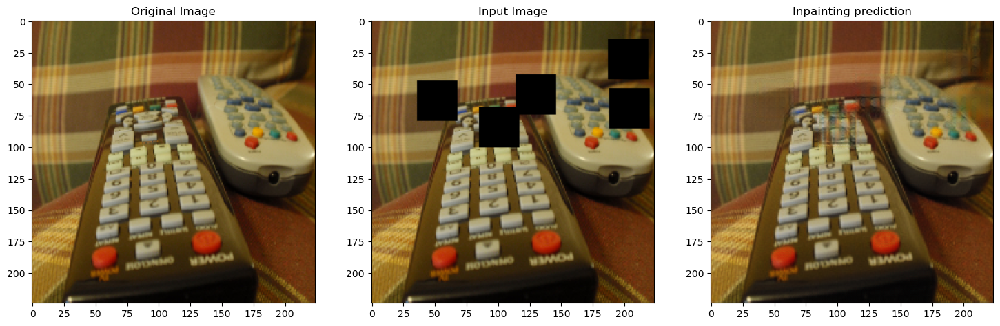

 45%|████▍     | 13/29 [00:12<00:12,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


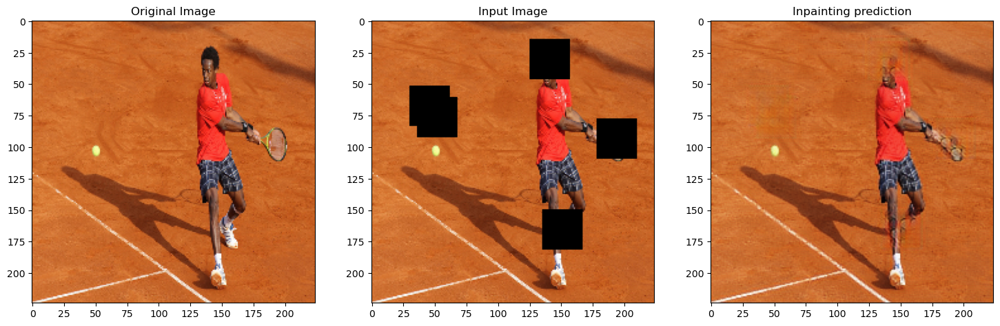

 48%|████▊     | 14/29 [00:13<00:12,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


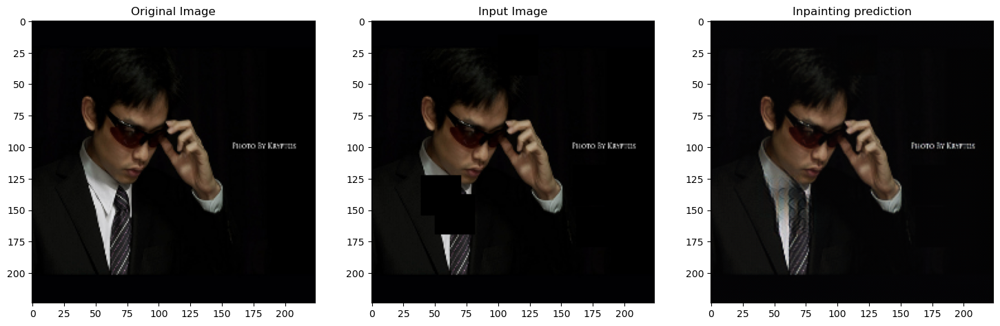

 52%|█████▏    | 15/29 [00:13<00:10,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


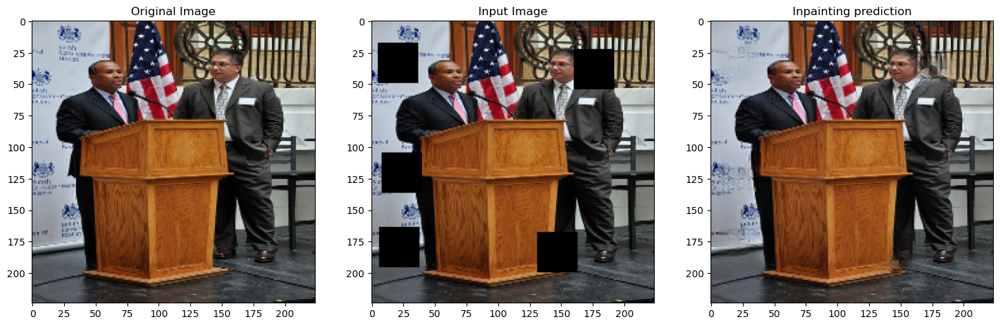

 55%|█████▌    | 16/29 [00:14<00:10,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


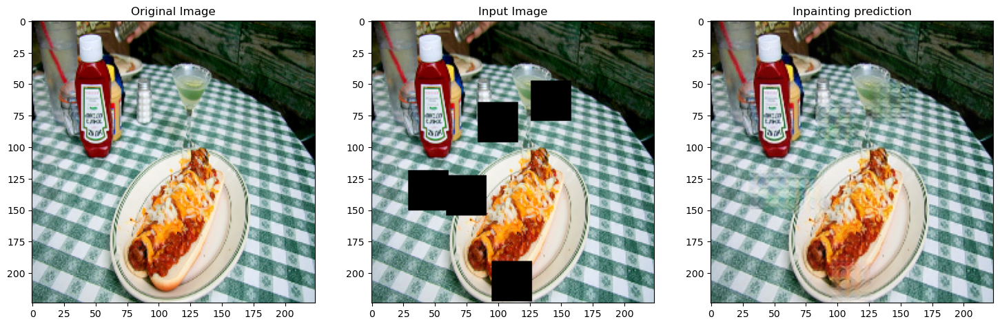

 59%|█████▊    | 17/29 [00:15<00:09,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


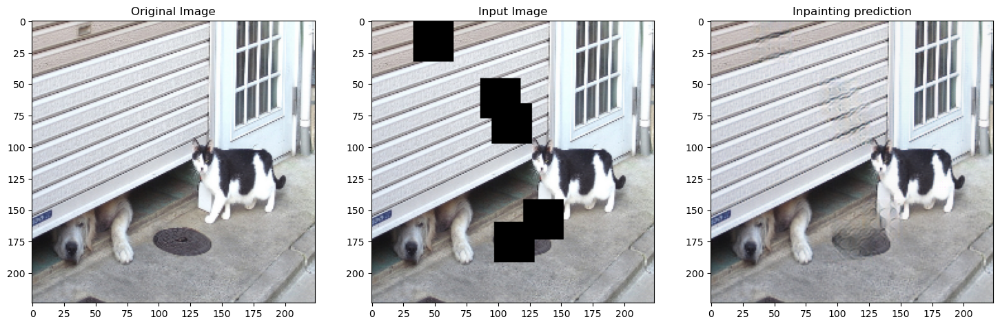

 62%|██████▏   | 18/29 [00:16<00:08,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


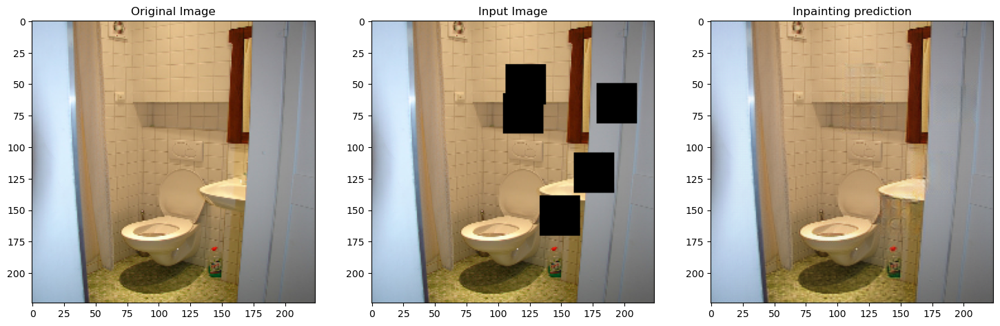

 66%|██████▌   | 19/29 [00:17<00:07,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


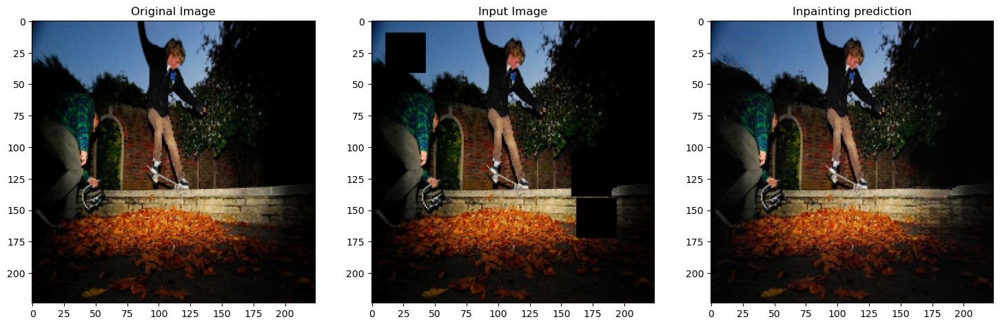

 69%|██████▉   | 20/29 [00:17<00:07,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


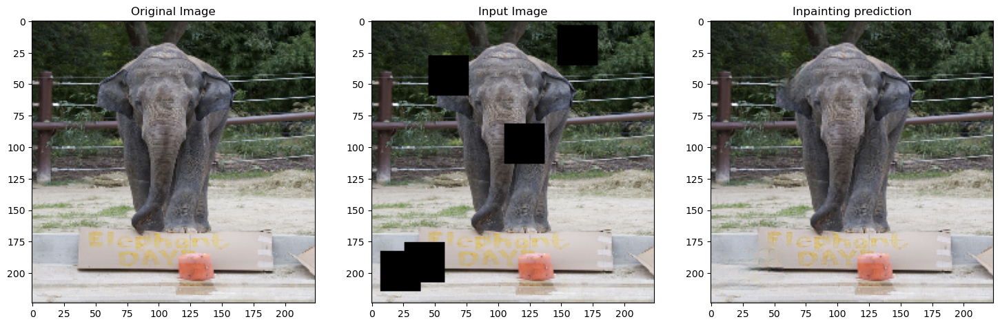

 72%|███████▏  | 21/29 [00:18<00:06,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


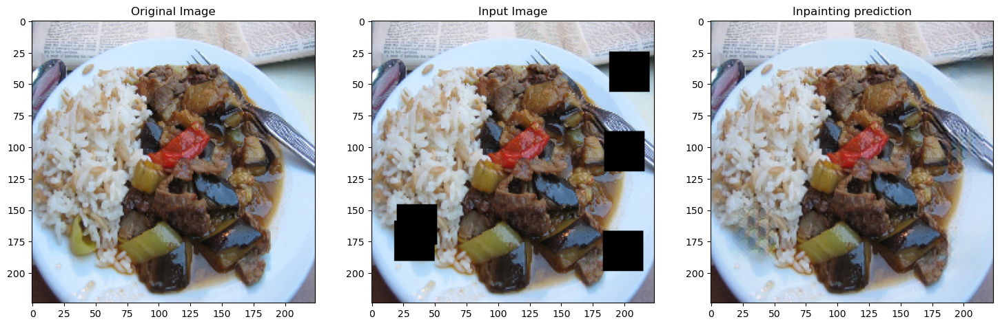

 76%|███████▌  | 22/29 [00:19<00:05,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


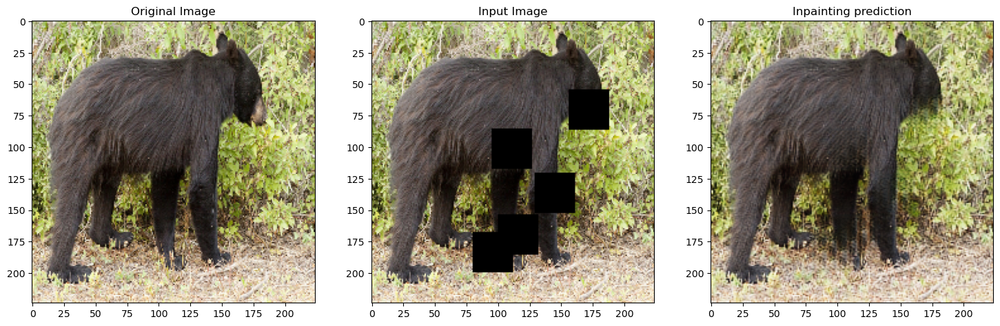

 79%|███████▉  | 23/29 [00:20<00:04,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


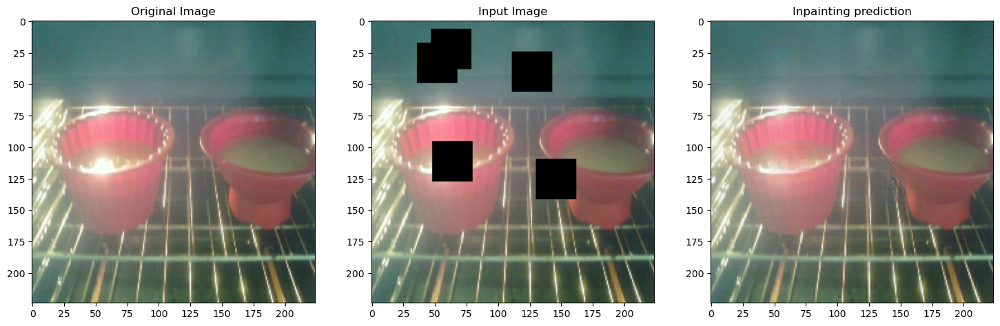

 83%|████████▎ | 24/29 [00:21<00:03,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


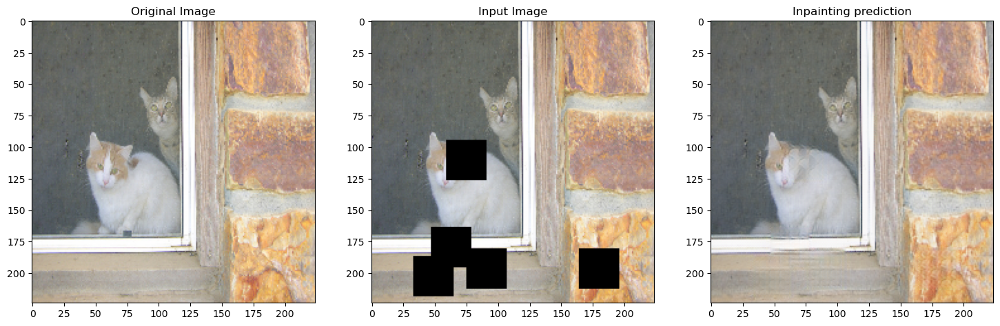

 86%|████████▌ | 25/29 [00:21<00:03,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


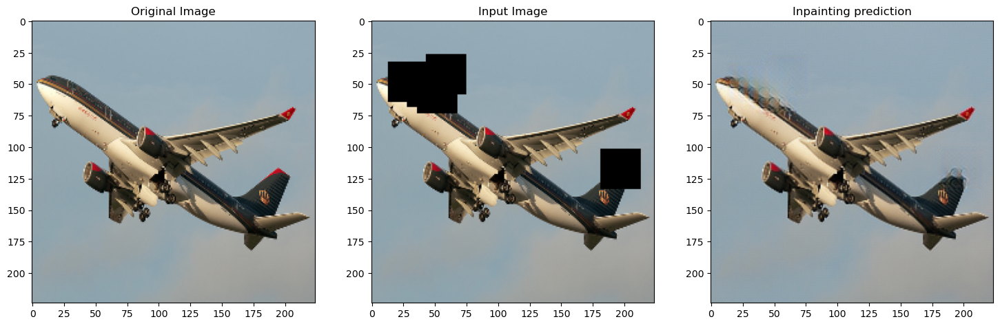

 90%|████████▉ | 26/29 [00:23<00:02,  1.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


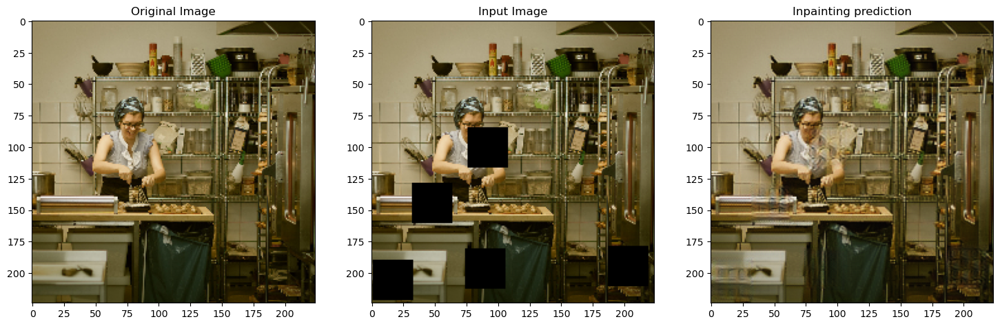

 93%|█████████▎| 27/29 [00:24<00:01,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


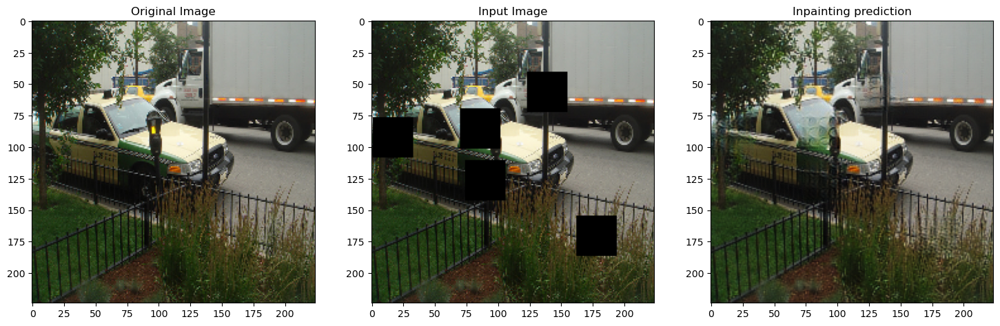

 97%|█████████▋| 28/29 [00:25<00:00,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


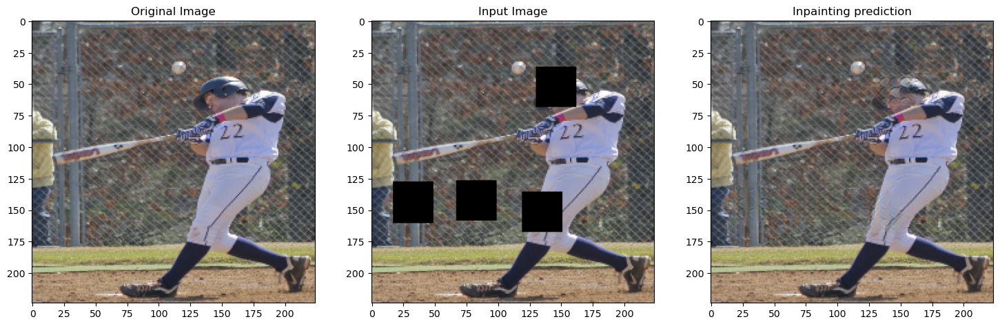

100%|██████████| 29/29 [00:25<00:00,  1.12it/s]


In [ ]:
test_dir = "~/Documents/dev/coco/test"
weights_dir = "~/Documents/dev/weights-099-0.1612.weights.h5"


# Preprocess
x_test, y_true = get_dataset(test_dir)

# Define model
model = ResNet18(mode='inpainting')
model.load_weights(weights_dir)

predictions = []

for (input_img, gt_image) in tqdm(zip(x_test, y_true), total=len(x_test)):
    predict = model.predict(input_img)
    input_img = tf.squeeze(input_img, axis=0)
    gt_img = tf.squeeze(gt_image)
    predict = tf.squeeze(predict, axis=0)

    

    f, axarr = plt.subplots(1,3, figsize=(18,6))
    axarr[0].imshow(gt_img)
    axarr[0].set_title(f"Original Image")
    axarr[1].imshow(input_img)
    axarr[1].set_title("Input Image")
    axarr[2].imshow(predict)
    axarr[2].set_title("Inpainting prediction")
    plt.show()